# Diagnóstico de cáncer de mama con regresión logística

El propósito de este proyecto es construir un modelo de regresión logística que sea capaz de diagosticar los tejidos mamarios para clasificar entre tumores benignos y malignos a partir de diferentes características como el radio, perímetro, área, textura, suavidad, compacidad, entre otras.

Un tumor es una masa de tejido que crece abultadamente y que a veces puede ser palpable; se desarrolla en un órgano determinado y no siempre imita el mismo tejido del órgano. Un tumor benigno es aquel que sigue generando e imitando células normales pero que no invaden al organismo; por el contrario, un tumor es maligno cuando la reproducción celular es descontrolada, desordenada e invade otras zonas del cuerpo.

![Benigno](benigno.png) <br>
![Maligno](maligno.png)

## Regresión logística binomial para clasificación de tumores

Queremos predecir si el diagnóstico es benigno o maligno, o sea, tenemos dos posibles clases lo cual hace indicado utilizar una regresión logística binomial.

### Librerías

**Instalación de las librerías necesarias**

In [1]:
# %pip install numpy pandas matplotlib seaborn sklearn imblearn

**Importar las librerías**

In [2]:
# Numpy y Pandas para manejo de datos
import numpy as np
import pandas as pd
# Matplot y Seaborn para visualización
import matplotlib.pyplot as plt
import seaborn as sns
# Sklearn para escalar los datos, hacer el split de los datos, construir el modelo, entrenar el modelo y evaluar el modelo 
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
# Imblearn para muestreo
from imblearn.over_sampling import SMOTE

### Establecer una apariencia general para los gráficos

In [3]:
%matplotlib inline
# Cuadrícula blanca; contexto de un notebook
sns.set(style = "whitegrid", context = "notebook")
# Tamaño de los gráficos
plt.rcParams["figure.figsize"] = (12, 10)
# Paleta de colores para los diagnósticos
diagnosisColors = {
    0 : "#F283B6",
    1 : "#6B5CA5"
}

### Cargar el conjunto de datos

In [4]:
df = pd.read_csv("data.csv")
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


### Validación de los datos

In [5]:
df.shape

(569, 33)

Tenemos 569 observaciones y 33 variables.

In [6]:
print(df.dtypes, df.dtypes.value_counts(), sep = "\n\n")

id                           int64
diagnosis                   object
radius_mean                float64
texture_mean               float64
perimeter_mean             float64
area_mean                  float64
smoothness_mean            float64
compactness_mean           float64
concavity_mean             float64
concave points_mean        float64
symmetry_mean              float64
fractal_dimension_mean     float64
radius_se                  float64
texture_se                 float64
perimeter_se               float64
area_se                    float64
smoothness_se              float64
compactness_se             float64
concavity_se               float64
concave points_se          float64
symmetry_se                float64
fractal_dimension_se       float64
radius_worst               float64
texture_worst              float64
perimeter_worst            float64
area_worst                 float64
smoothness_worst           float64
compactness_worst          float64
concavity_worst     

Solo tenemos una variable categórica que es el diagnóstico; el resto de las variables son numéricas.

In [7]:
df.isnull().sum()

id                           0
diagnosis                    0
radius_mean                  0
texture_mean                 0
perimeter_mean               0
area_mean                    0
smoothness_mean              0
compactness_mean             0
concavity_mean               0
concave points_mean          0
symmetry_mean                0
fractal_dimension_mean       0
radius_se                    0
texture_se                   0
perimeter_se                 0
area_se                      0
smoothness_se                0
compactness_se               0
concavity_se                 0
concave points_se            0
symmetry_se                  0
fractal_dimension_se         0
radius_worst                 0
texture_worst                0
perimeter_worst              0
area_worst                   0
smoothness_worst             0
compactness_worst            0
concavity_worst              0
concave points_worst         0
symmetry_worst               0
fractal_dimension_worst      0
Unnamed:

Vemos que hay toda una columna llena de valores nulos por lo que habrá que eliminarla; por otro lado, no parece que tengamos más valores faltantes.

### Manipulación y limpieza de los datos

Lo primero será eliminar la columna llena de valores nulos y también eliminaremos el ID ya que no nos aporta nada.

In [8]:
# Eliminar las columnas de unnamed y el id del conjunto de datos
df.drop(["Unnamed: 32", "id"], axis = 1, inplace = True)
df.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


Ahora convertiremos la variable target *diagnosis* a tipo numérica porque es más fácil para el algoritmo trabajar con ella de esta forma.

In [9]:
df.diagnosis.replace({
    # Benigno = 0; Maligno = 1
    "B" : 0,
    "M": 1
}, inplace = True)

df.diagnosis

0      1
1      1
2      1
3      1
4      1
      ..
564    1
565    1
566    1
567    1
568    0
Name: diagnosis, Length: 569, dtype: int64

Finalmente, creamos una copia del dataframe procesado para comenzar a trabajar con ella.

In [10]:
# Creamos un nuevo objeto que contiene toda la información del df original ya procesado
dfProcessed = df.copy(deep = True)
dfProcessed.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,1,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,1,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,1,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,1,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


### Análisis de correlación

Comenzaremos visualizando la proporción de benignos y malignos.

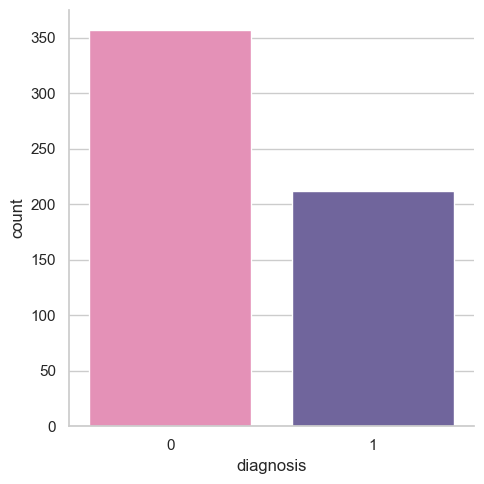

In [11]:
sns.catplot(
    data = dfProcessed,
    x = "diagnosis",
    kind = "count",
    palette = diagnosisColors    
)
plt.show()

Observamos que hay más diagnósticos benignos que malignos por lo cual tendremos que utilizar metodologías más adelante para obtener un muestreo equilibrado.

Ahora exploraremos la correlación que existe entre las variables utilizando un mapa de calor.

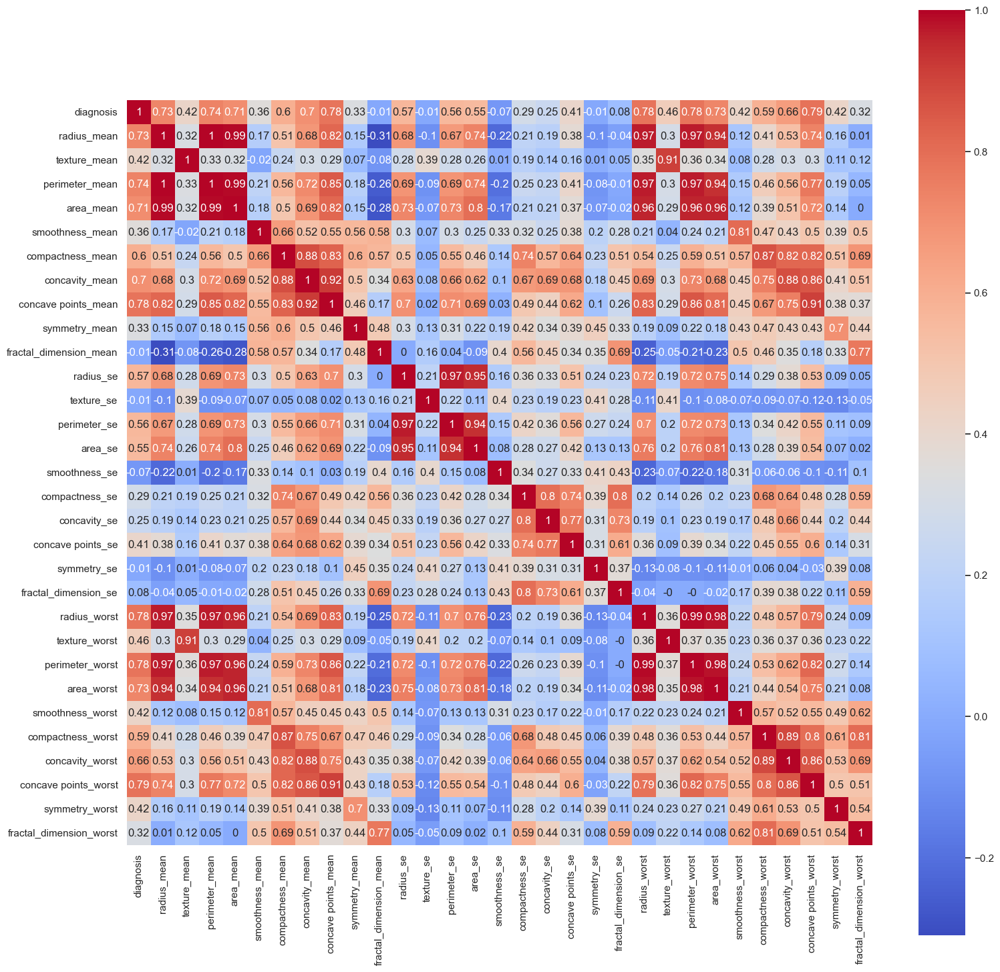

In [12]:
plt.figure(figsize = (18, 18))
sns.heatmap(
    data = dfProcessed.corr().round(2),
    annot = True,
    cmap = "coolwarm",
    square = True
)
plt.show()

Para ver esto de una manera más sencilla utilizaremos el siguiente gráfico.

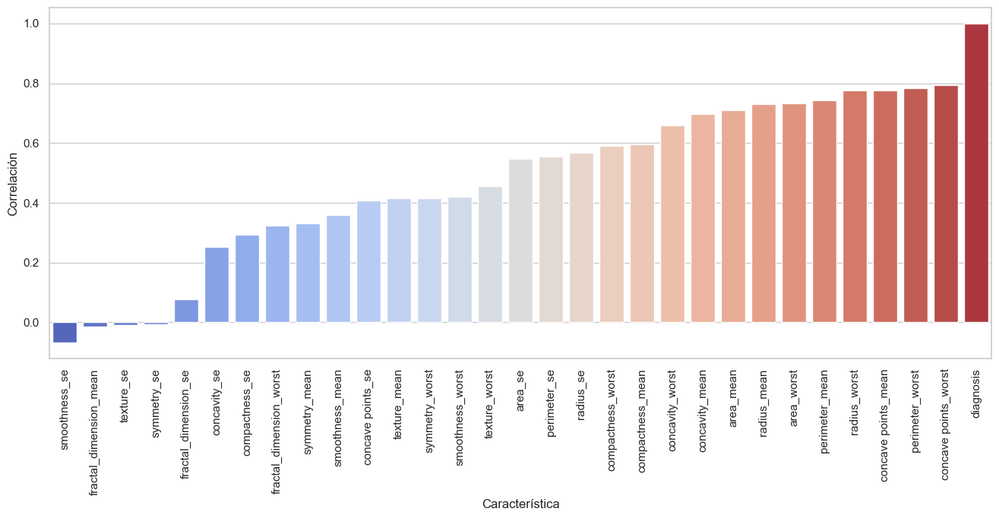

In [14]:
# Correlación respecto a la variable diagnosis; organizamos los valores de manera ascendente
dataCorr = (dfProcessed.corr()["diagnosis"].sort_values(ascending = True)).reset_index()

# Utilizamos un gráfico de barras rotado a 90° para mostrar la correlación
plt.figure(figsize = (16, 6)) 
sns.barplot(
    data = dataCorr,
    x = "index",
    y = "diagnosis",
    palette = "coolwarm"
)
plt.xlabel("Característica")
plt.ylabel("Correlación")
plt.xticks(rotation = 90)
plt.show()

Observamos que las variables que están más relacionadas con el tipo de diagnóstico son: *concave points_worst*, *perimeter_worst*, *concave points_mean*, *radius_worst*, *perimeter_mean*, *area_worst*, *radius_mean*, *area_mean*, *concavity_mean*, *concavity_worst*, *compactness_worst* y *compactness_mean*.

También es posible observar que *area_worst*, *perimeter_worst* y *radius_worst* nos prácticamente la misma información que su versión *mean*; también que *radius_mean* nos da casi la misma información que *area_mean* y *perimeter_mean*. Esto lo utilizaremos más adelante para mejorar el modelo.

In [20]:
sns.pairplot(
    data = dfProcessed, 
    hue = "diagnosis",
    palette = diagnosisColors,
)
plt.show()

A simple vista podemos observar que hay una clara segmentación de los puntos de datos dependiendo si el diagnóstico es benigno o maligno lo que apoya la idea de hacer una clasificación.

### Balancear el conjunto de datos

Como observamos nuestro conjunto de datos está desbalanceado respecto al número de diagnósticos benignos y malignos así que aplicaremos la metodología SMOTE: Técnica estadística de sobremuestreo de minorías sintéticas para aumentar el número de muestras del conjunto de datos y hacer que esté más equilibrado.

Primero dividiremos el conjunto de datos entre las variables predictoras y la variable target.

In [15]:
# Variables predictoras
X = dfProcessed.drop("diagnosis", axis = 1)
# Variable target
y = dfProcessed.diagnosis.values

Ahora aplicamos SMOTE.

In [16]:
# Aplicamos SMOTE para balancear el dataset
oversample = SMOTE()
XSmote, ySmote = oversample.fit_resample(X, y)

### Escalar los datos y división en conjunto de training y testing

Escalamos los datos para que sea más fácil para el algoritmo entender cómo manejar las variables y dividiremos entre conjunto de entrenamiento y conjunto de testing.

In [17]:
# Creamos el escalador
scaler = StandardScaler()
# Dividimos los datos en entrenamiento y testing
XTrainSmote, XTestSmote, yTrainSmote, yTestSmote = train_test_split(XSmote, ySmote, test_size = 0.2, random_state = 42)
# Escalamos las variables predictoras
XTrainSmoteScaled = scaler.fit_transform(XTrainSmote) 
XTestSmoteScaled = scaler.fit_transform(XTestSmote)

### Construcción y entrenamiento del modelo

Ahora procedemos a construir el modelo y a entrenarlo.

In [18]:
# Creamos el modelo
logisticReg = LogisticRegression(max_iter = 10000)
# Entrenamos el modelo
logisticReg.fit(XTrainSmoteScaled, yTrainSmote)
# Creamos unas predicciones con el modelo
predictions = logisticReg.predict(XTestSmoteScaled)

### Evaluar el modelo

Una vez tenemos el modelo entrenado y con algunas predicciones entonces procedemos a evaluar su precisión.

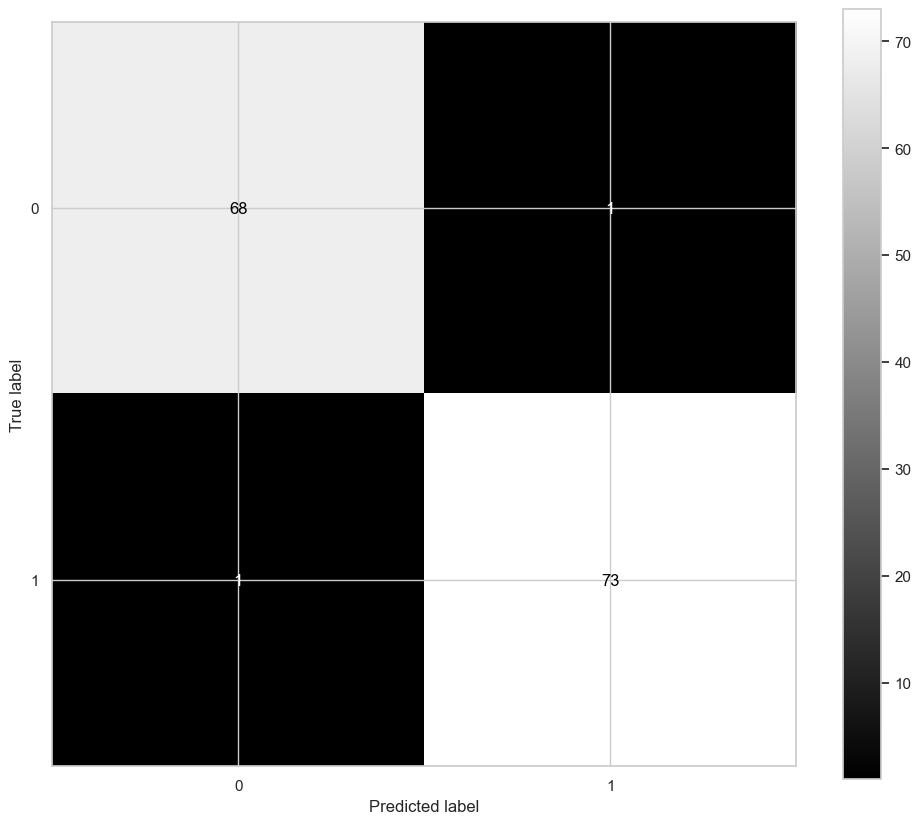

Precisión del modelo: 98.6% 
Precisión benignos: 98.6% 
Precisión malignos: 98.6%


In [21]:
# Creamos la matriz de confusión
cmSmote = confusion_matrix(yTestSmote, predictions, labels = logisticReg.classes_)
dispSmote = ConfusionMatrixDisplay(confusion_matrix = cmSmote, display_labels = logisticReg.classes_)
# Mostramos la matriz de confusión
dispSmote.plot(cmap = "gray")
plt.show()

print(f"Precisión del modelo: {metrics.accuracy_score(yTestSmote, predictions).round(3) * 100}% \nPrecisión benignos: {metrics.recall_score(yTestSmote, predictions, pos_label = 0).round(3) * 100}% \nPrecisión malignos: {metrics.recall_score(yTestSmote, predictions, pos_label = 1).round(3) * 100}%")

Con esto tenemos un modelo con una precisión del 98.6% a la hora de clasificar si un tumor es benigno o maligno.